In [3]:
import psycopg2
import pandas as pd
import numpy as np
import geopandas as gpd
import matplotlib.pyplot as plt
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
from cluster_helpers import pooled_within_ssd, gap_statistic
from cluster_helpers import cluster_range, plot_clusters
from cluster_helpers import plot_internal, get_kdist
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from getpass import getpass

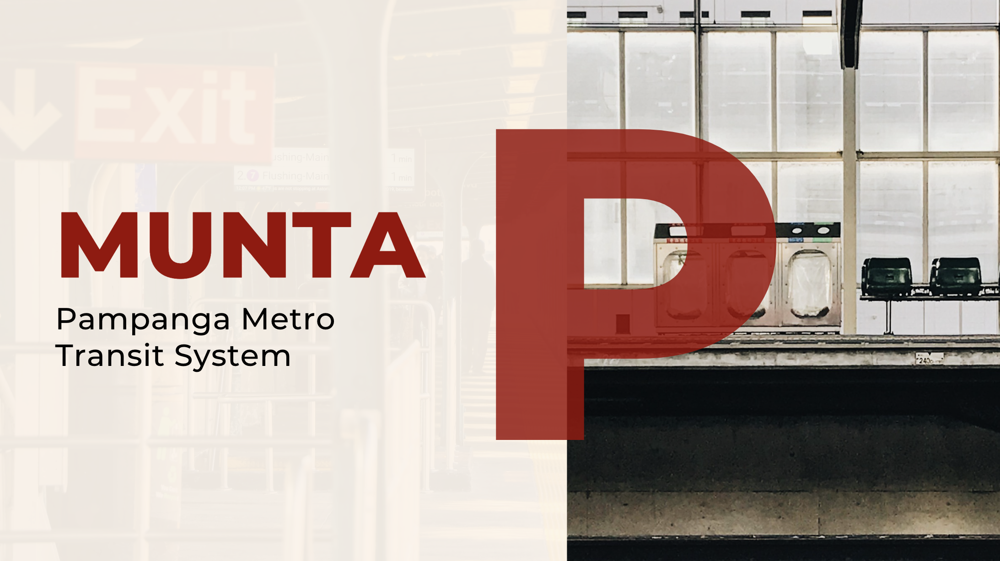

<a id='Header2'></a>
<h1 style="color:#ffffff; background-color:darkred; padding: 20px 0; text-align: left; font-weight: bold; padding-left: 20px;">PROBLEM STATEMENT AND RATIONALE</h1><a id='ExecSum'></a><a id='Title'></a><a

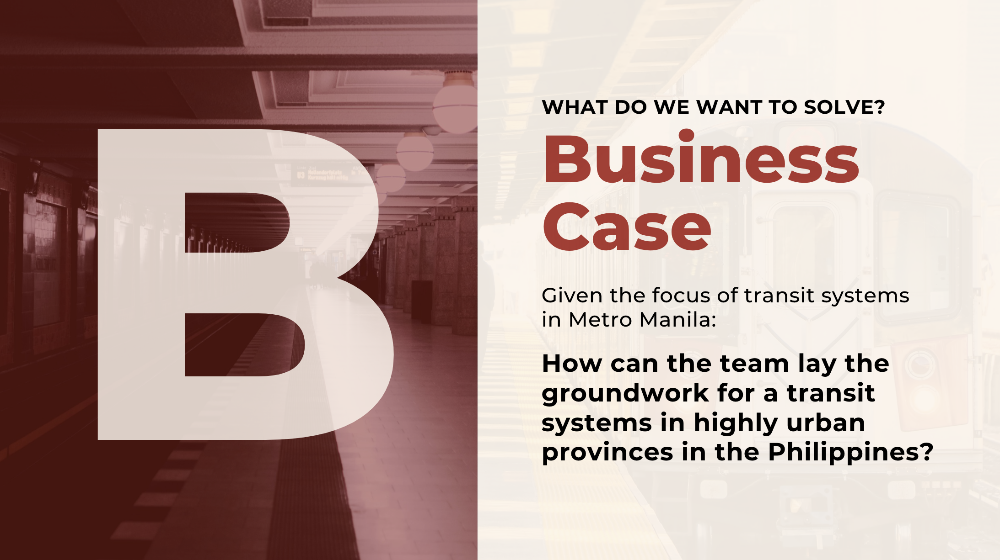

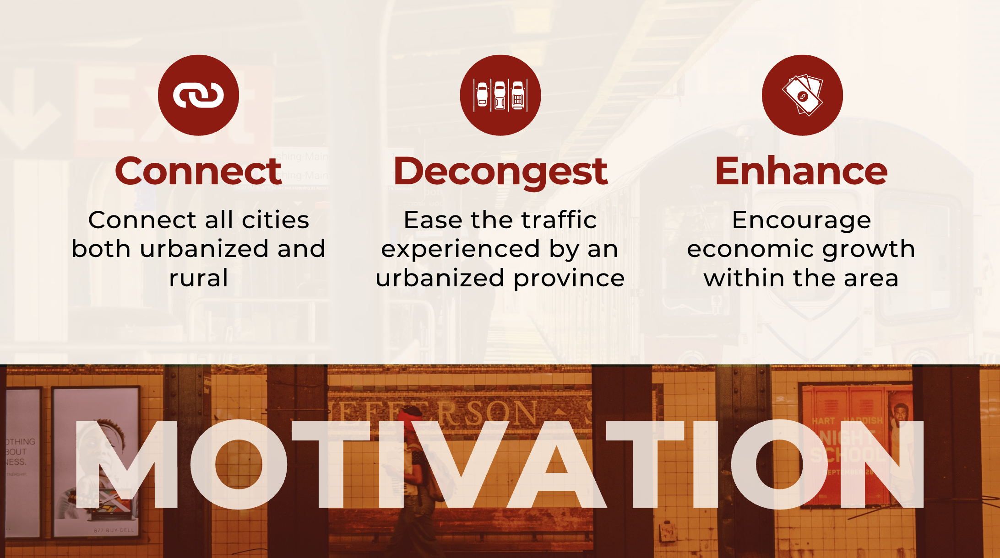

<a id='Header2'></a>
<h1 style="color:#ffffff; background-color:darkred; padding: 20px 0; text-align: left; font-weight: bold; padding-left: 20px;">METHODOLOGY OVERVIEW</h1><a id='ExecSum'></a><a id='Title'></a><a

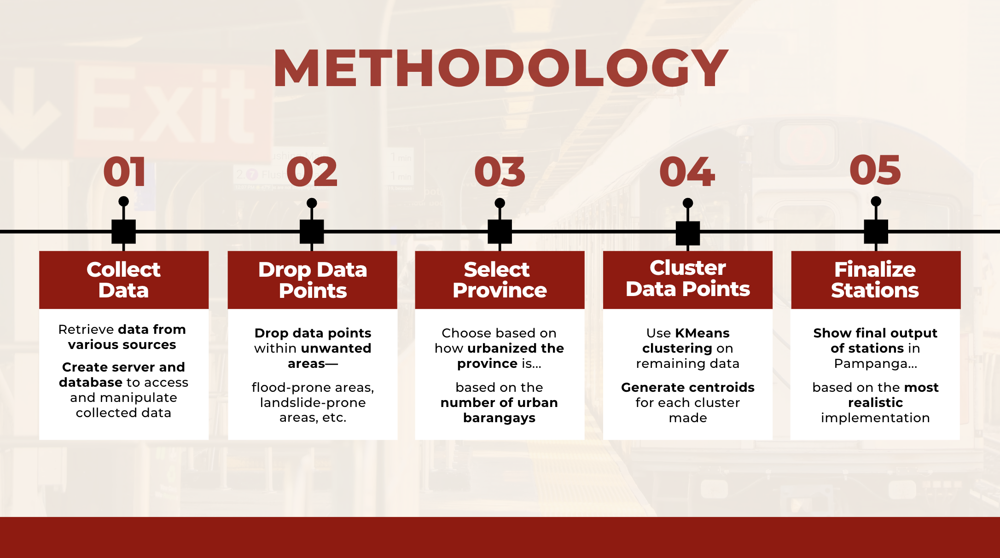

<a id='Header2'></a>
<h1 style="color:#ffffff; background-color:darkred; padding: 20px 0; text-align: left; font-weight: bold; padding-left: 20px;">DATA COLLECTION</h1><a id='ExecSum'></a><a id='Title'></a><a

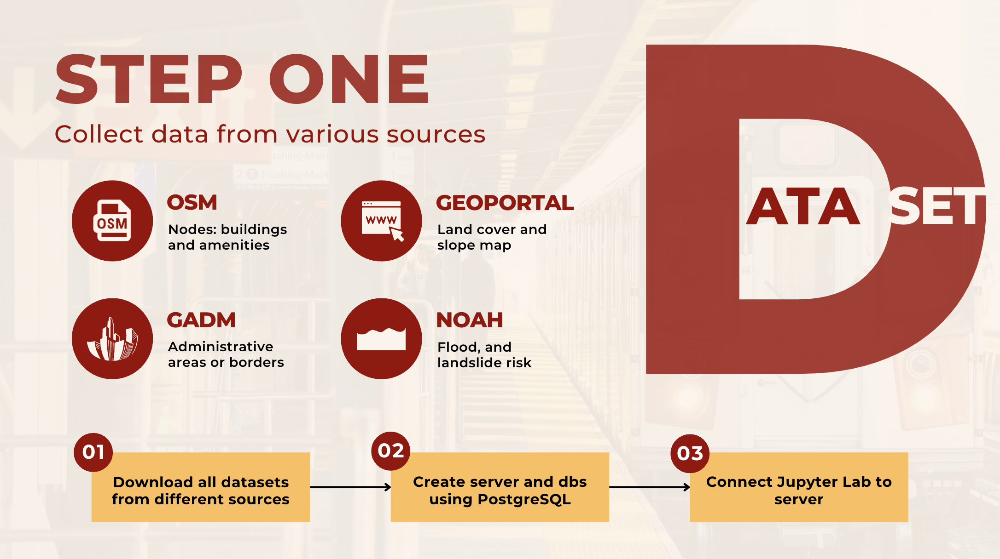

# **Connecting to Local PostgreSQL Server**

In [2]:
password = getpass()

········


In [4]:
conn = psycopg2.connect(dbname="osm_ph", 
                 user="postgres", 
                 password=password, 
                 host="localhost", 
                 port=5432)

# **Acquiring the Most Urbanized Provinces**

In [4]:
df_urban = pd.read_excel('Urban_Barangays.xlsx', sheet_name='Table C', nrows=83,
                         names=['Province', 'Total Number of Barangays', 
                                  'Total Number of Urban Barangays'])

In [5]:
df_urban['Proportion of Urban Barangays'] = (df_urban['Total Number of Urban Barangays']
                                             /df_urban['Total Number of Barangays'])
print('Table 1: Proportion of Urbanized Barangays per Province')
display(df_urban
        .sort_values('Proportion of Urban Barangays', 
                     ascending=False)
        .head(10))

Table 1: Proportion of Urbanized Barangays per Province


,Province,Total Number of Barangays,Total Number of Urban Barangays,Proportion of Urban Barangays
48,Metropolitan Manila,1710,1710,1.000000
16,Bulacan,569,364,0.639719
65,Rizal,189,109,0.576720
61,Pampanga,538,301,0.559480
52,Negros Occidental,662,287,0.433535
71,South Cotabato,225,93,0.413333
27,Davao del Sur,414,171,0.413043
23,Cavite,829,333,0.401689
41,Laguna,681,244,0.358297
12,Benguet,269,96,0.356877


# **Retrieve Pampanga Area Cut**

In [17]:
cities_pampanga = gpd.read_postgis("""
SELECT
    adm_2."NAME_2", ST_TRANSFORM(geom, 3123) as geom
FROM
    adm_2
WHERE
    adm_2."NAME_1" = 'Pampanga'
""", con=conn, geom_col='geom')

/Users/pmmedina/anaconda3/lib/python3.10/site-packages/geopandas/io/sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


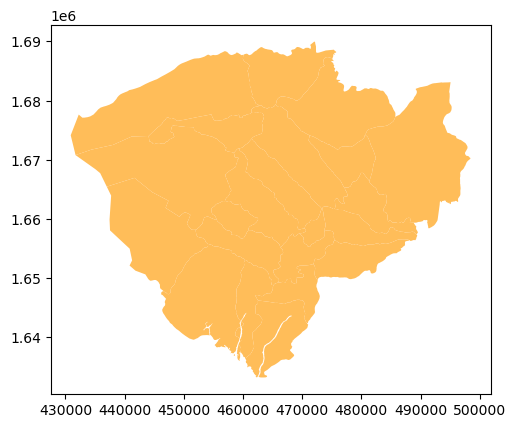

In [20]:
cities_pampanga.plot(color='#ffbd59')
plt.show()

# **Retrieve Amenities in Pampanga**

In [22]:
df_2 = gpd.read_postgis("""
SELECT 
    planet_osm_point.*, ST_TRANSFORM(planet_osm_point.way, 3123) AS way2
FROM 
    adm_1, planet_osm_point
WHERE 
    adm_1."NAME_1" = 'Pampanga' 
AND
    ST_WITHIN(ST_Transform(planet_osm_point.way, 3123), ST_TRANSFORM(adm_1.geom, 3123)) 
""", con=conn, geom_col='way2')

/Users/pmmedina/anaconda3/lib/python3.10/site-packages/geopandas/io/sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


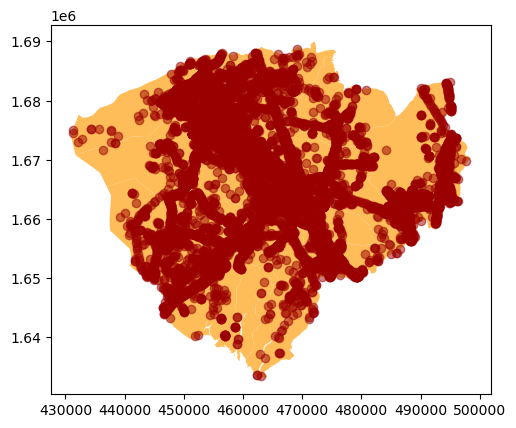

In [33]:
# Without Filter
ax = cities_pampanga.plot(color='#ffbd59')
df_2.plot(color='#9B0000', ax=ax, alpha=0.5)
plt.show()

# **Retrieve Landslide Hazard Area**

In [62]:
# Landslide Hazard
df_landslide = gpd.read_postgis("""
SELECT 
    geom
FROM 
    pampanga_landslidehazards
WHERE 
    (pampanga_landslidehazards.aud = 2 OR pampanga_landslidehazards.aud = 3)
""", con=conn, geom_col='geom')

/Users/pmmedina/anaconda3/lib/python3.10/site-packages/geopandas/io/sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


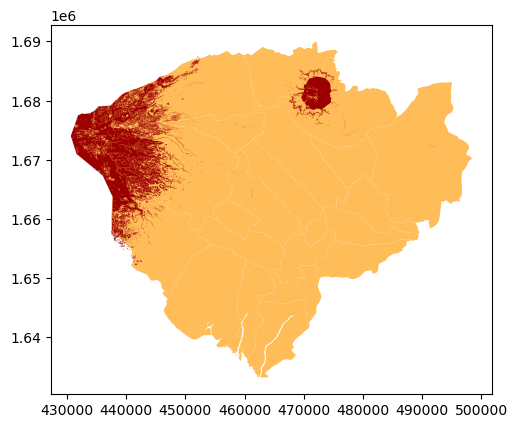

In [63]:
ax = cities_pampanga.plot(color='#ffbd59')
df_landslide.plot(color='#9B0000', ax=ax)
plt.show()

# **Retrieve 100 Year Flood Hazard Areas**

In [59]:
# Flood
df_flood = gpd.read_postgis("""
SELECT 
    geom
FROM 
    pampanga_flood_100year
WHERE 
    (pampanga_flood_100year.var = 2 OR pampanga_flood_100year.var = 3)
""", con=conn, geom_col='geom')

/Users/pmmedina/anaconda3/lib/python3.10/site-packages/geopandas/io/sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


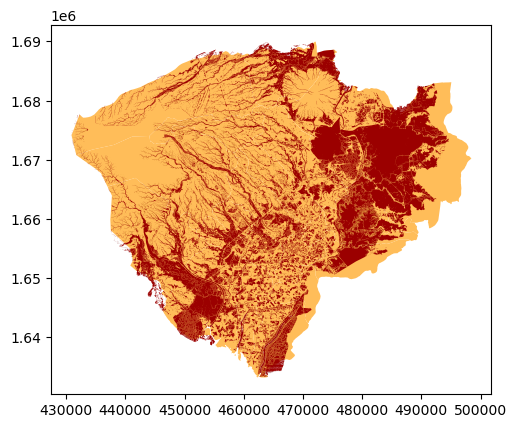

In [60]:
ax = cities_pampanga.plot(color='#ffbd59')
df_flood.plot(color='#9B0000', ax=ax)
plt.show()

# **Retrieve High Sloping Areas**

In [57]:
# Slope
df_slope = gpd.read_postgis("""
SELECT 
    geom
FROM 
    slp_pampanga
WHERE 
    (slp_pampanga.slope_code = 'B' OR slp_pampanga.slope_code = 'C' OR slp_pampanga.slope_code = 'D' OR
    slp_pampanga.slope_code = 'E')
""", con=conn, geom_col='geom')

/Users/pmmedina/anaconda3/lib/python3.10/site-packages/geopandas/io/sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


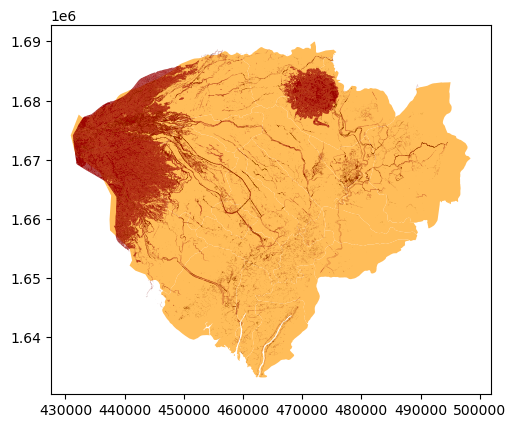

In [58]:
ax = cities_pampanga.plot(color='#ffbd59')
df_slope.plot(color='#9B0000', ax=ax)
plt.show()

# **Retrieve Areas with Bodies of Water**

In [53]:
# Land Cover
df_land_cover = gpd.read_postgis("""
SELECT 
    geom
FROM 
    egdmis_landcover2015
WHERE 
    (egdmis_landcover2015.agg12 = 'Inland Water' OR egdmis_landcover2015.agg12 = 'Marshland/Swamp' OR
    egdmis_landcover2015.agg12 = 'Fishpond')
AND
    egdmis_landcover2015.province = 'PAMPANGA'
""", con=conn, geom_col='geom')

/Users/pmmedina/anaconda3/lib/python3.10/site-packages/geopandas/io/sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


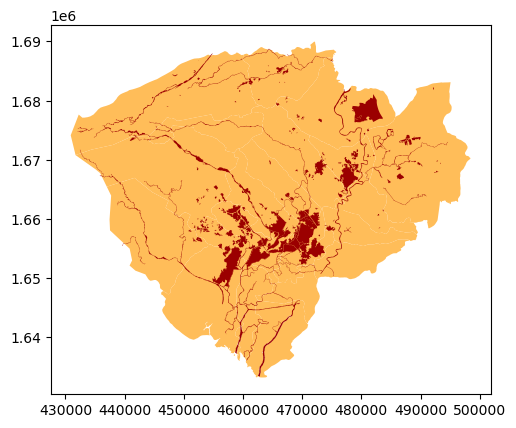

In [55]:
ax = cities_pampanga.plot(color='#ffbd59')
df_land_cover.plot(color='#9B0000', ax=ax)
plt.show()

<a id='Header2'></a>
<h1 style="color:#ffffff; background-color:darkred; padding: 20px 0; text-align: left; font-weight: bold; padding-left: 20px;">DATA PRE-PROCESSING</h1><a id='ExecSum'></a><a id='Title'></a><a

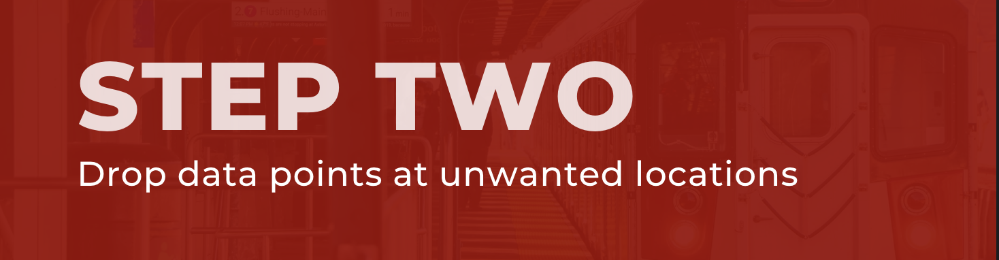

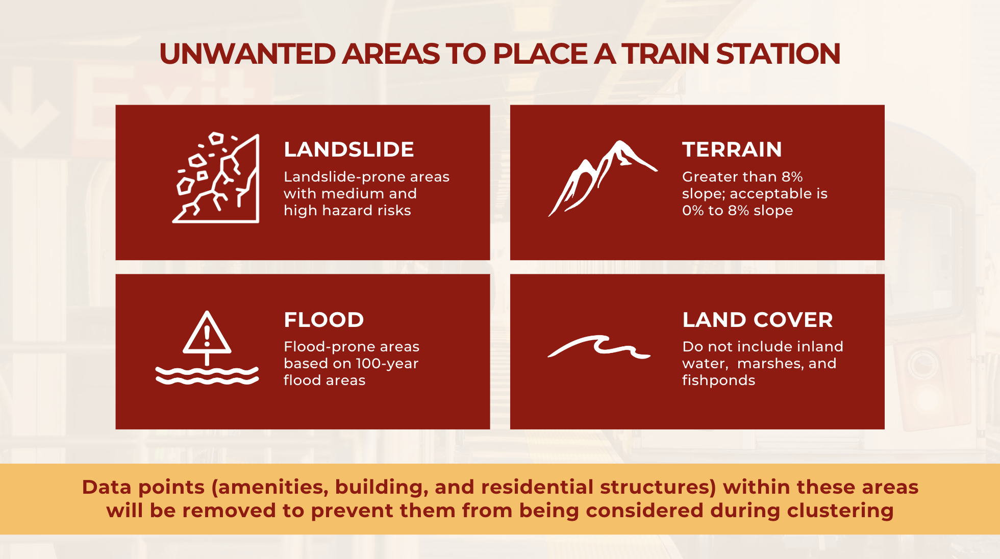

# **Remove Amenities in Landslide Hazard Areas**

In [23]:
df_3 = gpd.read_postgis("""
SELECT 
    planet_osm_point.*, ST_TRANSFORM(planet_osm_point.way, 3123) AS way2
FROM 
    planet_osm_point
JOIN
    pampanga_landslidehazards
ON 
    ST_WITHIN(ST_Transform(planet_osm_point.way, 3123), ST_TRANSFORM(pampanga_landslidehazards.geom, 3123))
WHERE 
    (pampanga_landslidehazards.aud = 2 OR pampanga_landslidehazards.aud = 3)
""", con=conn, geom_col='way2')

/Users/pmmedina/anaconda3/lib/python3.10/site-packages/geopandas/io/sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


In [34]:
landslide = df_3['osm_id'].values.tolist()

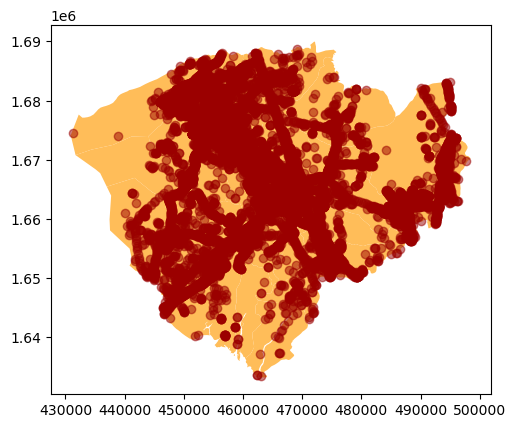

In [37]:
df = df_2.copy()
df = df[~df['osm_id'].isin(landslide)]
ax = cities_pampanga.plot(color='#ffbd59')
df.plot(color='#9B0000', ax=ax, alpha=0.5)
plt.show()

# **Remove Amenities in 100 Year Flood Hazard Areas**

In [24]:
df_4 = gpd.read_postgis("""
SELECT 
    planet_osm_point.*, ST_TRANSFORM(planet_osm_point.way, 3123) AS way2
FROM 
    planet_osm_point
JOIN
    adm_1
ON
    ST_WITHIN(ST_Transform(planet_osm_point.way, 3123), ST_TRANSFORM(adm_1.geom, 3123)) 
JOIN    
    pampanga_flood_100year
ON
    ST_WITHIN(ST_Transform(planet_osm_point.way, 3123), ST_TRANSFORM(pampanga_flood_100year.geom, 3123))
WHERE 
    (pampanga_flood_100year.var = 2 OR pampanga_flood_100year.var = 3) AND
    adm_1."NAME_1" = 'Pampanga' 
""", con=conn, geom_col='way2')

/Users/pmmedina/anaconda3/lib/python3.10/site-packages/geopandas/io/sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


In [38]:
flood = df_4['osm_id'].values.tolist()

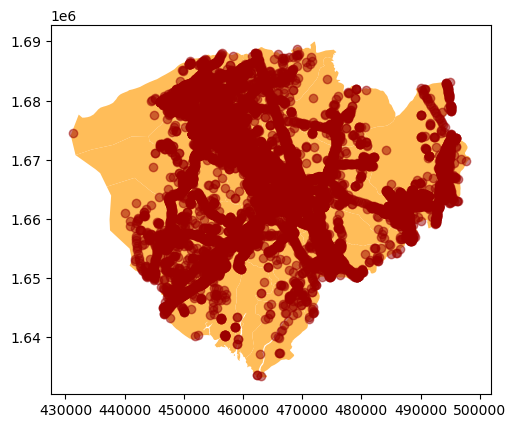

In [39]:
df = df[~df['osm_id'].isin(flood)]
ax = cities_pampanga.plot(color='#ffbd59')
df.plot(color='#9B0000', ax=ax, alpha=0.5)
plt.show()

# **Remove Amenities in High Sloping Areas**

In [25]:
df_5 = gpd.read_postgis("""
SELECT 
    planet_osm_point.*, ST_TRANSFORM(planet_osm_point.way, 3123) AS way2
FROM 
    planet_osm_point
JOIN
    adm_1
ON
    ST_WITHIN(ST_Transform(planet_osm_point.way, 3123), ST_TRANSFORM(adm_1.geom, 3123))
JOIN
    slp_pampanga
ON
    ST_WITHIN(ST_Transform(planet_osm_point.way, 3123), ST_TRANSFORM(slp_pampanga.geom, 3123))
WHERE 
    (slp_pampanga.slope_code = 'B' OR slp_pampanga.slope_code = 'C' OR slp_pampanga.slope_code = 'D' OR
    slp_pampanga.slope_code = 'E') AND
    adm_1."NAME_1" = 'Pampanga' 
""", con=conn, geom_col='way2')

/Users/pmmedina/anaconda3/lib/python3.10/site-packages/geopandas/io/sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


In [40]:
slope = df_5['osm_id'].values.tolist()

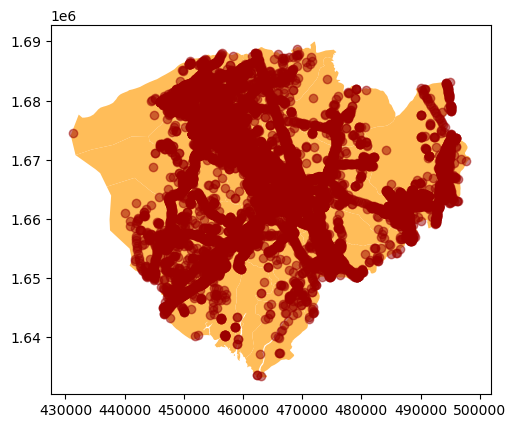

In [41]:
df = df[~df['osm_id'].isin(slope)]
ax = cities_pampanga.plot(color='#ffbd59')
df.plot(color='#9B0000', ax=ax, alpha=0.5)
plt.show()

# **Remove Amenities within Bodies of Water**

In [26]:
df_6 = gpd.read_postgis("""
SELECT 
    planet_osm_point.*, ST_TRANSFORM(planet_osm_point.way, 3123) AS way2
FROM 
    planet_osm_point
JOIN
    adm_1
ON
    ST_WITHIN(ST_Transform(planet_osm_point.way, 3123), ST_TRANSFORM(adm_1.geom, 3123))
JOIN
    egdmis_landcover2015
ON
    ST_WITHIN(ST_TRANSFORM(planet_osm_point.way, 3123), ST_TRANSFORM(egdmis_landcover2015.geom, 3123))
WHERE 
    (egdmis_landcover2015.agg12 = 'Inland Water' OR egdmis_landcover2015.agg12 = 'Marshland/Swamp' OR
    egdmis_landcover2015.agg12 = 'Fishpond')
AND
    egdmis_landcover2015.province = 'PAMPANGA' AND
    adm_1."NAME_1" = 'Pampanga' 
""", con=conn, geom_col='way2')

/Users/pmmedina/anaconda3/lib/python3.10/site-packages/geopandas/io/sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


In [42]:
land_cover = df_6['osm_id'].values.tolist()

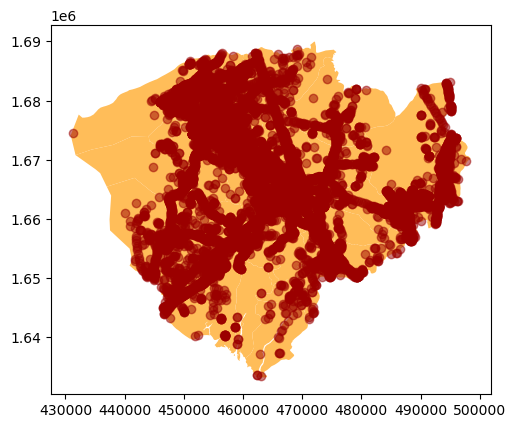

In [43]:
df = df[~df['osm_id'].isin(land_cover)]
ax = cities_pampanga.plot(color='#ffbd59')
df.plot(color='#9B0000', ax=ax, alpha=0.5)
plt.show()

# **Filter Out Irrelevant Amentities**

In [45]:
# Remove unrelated or irrelevant amenities
df = df[(df['amenity'] != 'social_facility') & (df['amenity'] != 'internet_cafe') &
(df['amenity'] != 'health_post') & (df['amenity'] != 'shelter') & 
(df['amenity'] != 'car_wash') & (df['amenity'] != 'toilets') & 
(df['amenity'] != 'fuel') & (df['amenity'] != 'vending_machine') & 
(df['amenity'] != 'parking') & (df['amenity'] != 'fountain') &
(df['amenity'] != 'hunting_stand') & (df['amenity'] != 'fire_station') &
(df['amenity'] != 'telephone') & (df['amenity'] != 'fountain') &
(df['amenity'] != 'parking_entrance') & (df['amenity'] != 'training') &
(df['amenity'] != 'clock') & (df['amenity'] != 'motorcycle_parking') & 
(df['amenity'] != 'yes') & (df['amenity'] != 'vehicle_inspection') &
(df['amenity'] != 'compressed_air') & (df['amenity'] != 'water_point') &
(df['amenity'] != 'conference_centre') & (df['amenity'] != 'waste_basket') &
(df['amenity'] != 'driving_school') & (df['amenity'] != 'car_rental') &
(df['amenity'] != 'social_facility without social_facility') &
(df['amenity'] != 'weighbridge') & (df['amenity'] != 'bicycle_rental') &
(df['amenity'] != 'charging_station') & (df['amenity'] != 'animal_breeding') &
(df['amenity'] != 'nursing_home') & (df['amenity'] != 'shower') &
(df['amenity'] != 'motorcycle_rental') & (df['amenity'] != 'bicycle_repair_station') &
(df['amenity'] != 'rescue_station') & (df['amenity'] != 'grave_yard')]

In [46]:
# Only include relevant, non-null OSM tags
df_removed = (df[(~df['addr:housename'].isna()) | (~df['addr:housenumber'].isna()) |
  (~df['brand'].isna()) | (~df['brand'].isna()) |
  (~df['amenity'].isna()) | (~df['building'].isna()) |
  (~df['denomination'].isna()) | (~df['historic'].isna()) |
  (~df['landuse'].isna()) | (~df['leisure'].isna()) |
  (~df['office'].isna()) | (~df['public_transport'].isna()) |
  (~df['religion'].isna()) | (~df['shop'].isna()) |
  (~df['sport'].isna()) | (~df['tourism'].isna()) |
  (~df['operator'].isna())])

In [47]:
# Remove irrelevant OSM tag names
df_removed = df_removed[(df_removed['building'] != 'shed') |
           (df_removed['tourism'] != 'caravan_site') |
           (df_removed['tourism'] != 'camp_site') |
          df_removed['landuse'] != 'orchard']

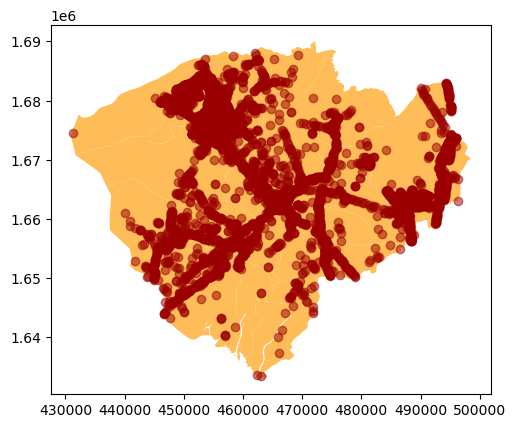

In [48]:
ax = cities_pampanga.plot(color='#ffbd59')
df_removed.plot(color='#9B0000', ax=ax, alpha=0.5)
plt.show()

<a id='Header2'></a>
<h1 style="color:#ffffff; background-color:darkred; padding: 20px 0; text-align: left; font-weight: bold; padding-left: 20px;">SELECT BEST PROVINCE FOR A TRANSIT SYSTEM</h1><a id='ExecSum'></a><a id='Title'></a><a

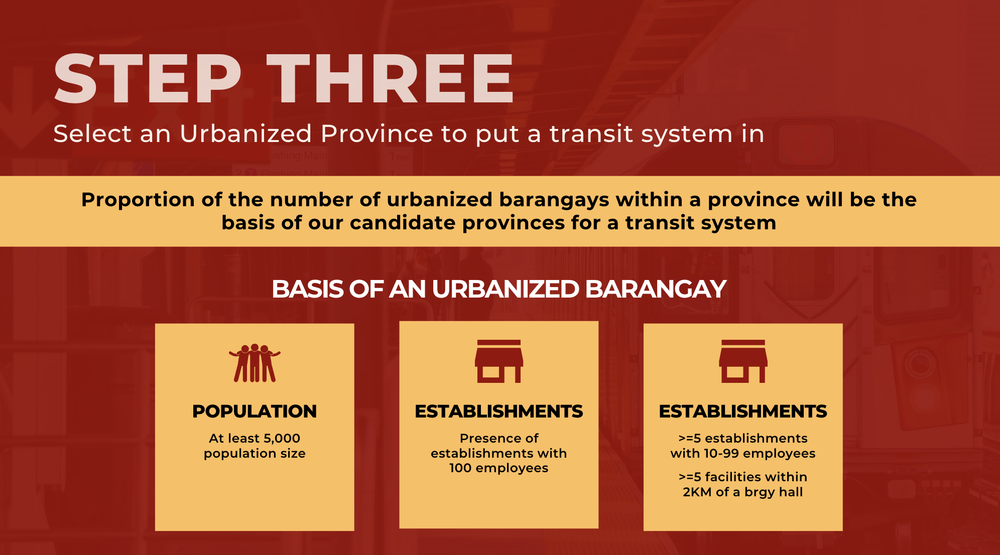

In [5]:
df_urban['Proportion of Urban Barangays'] = (df_urban['Total Number of Urban Barangays']
                                             /df_urban['Total Number of Barangays'])
print('Table 1: Proportion of Urbanized Barangays per Province')
display(df_urban
        .sort_values('Proportion of Urban Barangays', 
                     ascending=False)
        .head(10))

Table 1: Proportion of Urbanized Barangays per Province


,Province,Total Number of Barangays,Total Number of Urban Barangays,Proportion of Urban Barangays
48,Metropolitan Manila,1710,1710,1.000000
16,Bulacan,569,364,0.639719
65,Rizal,189,109,0.576720
61,Pampanga,538,301,0.559480
52,Negros Occidental,662,287,0.433535
71,South Cotabato,225,93,0.413333
27,Davao del Sur,414,171,0.413043
23,Cavite,829,333,0.401689
41,Laguna,681,244,0.358297
12,Benguet,269,96,0.356877


In [9]:
query = """
SELECT
    g."NAME_1", ST_union(g.geom) AS geom
FROM
    adm_2 g
GROUP BY
    g."NAME_1"
"""
province_shp = gpd.read_postgis(query, con=conn, geom_col='geom')

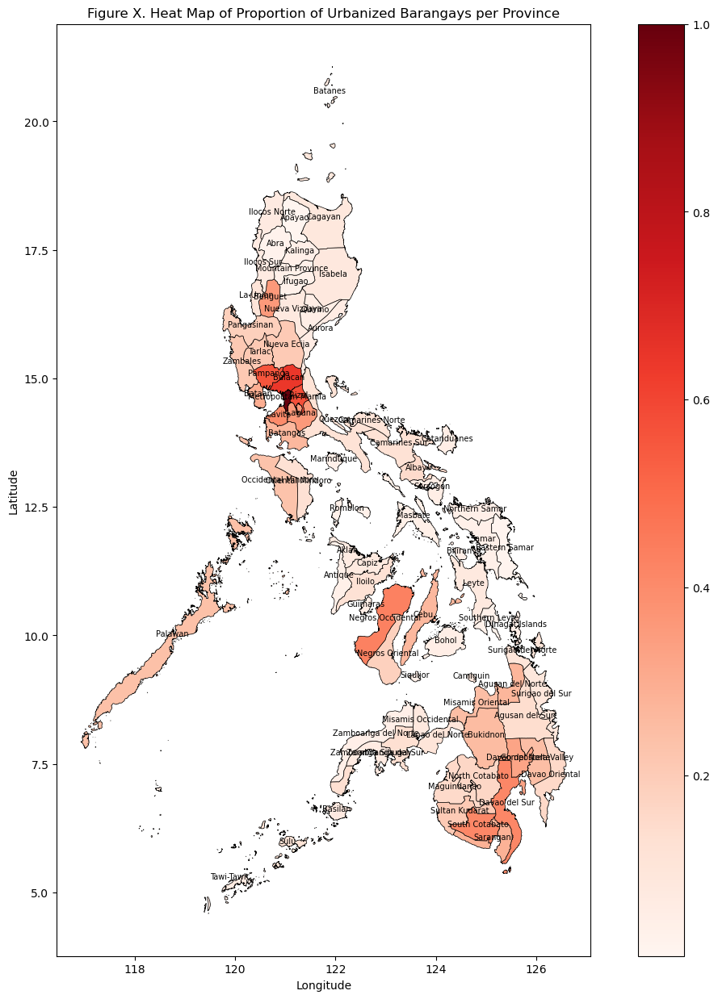

In [15]:
prov_urban = province_shp.merge(df_urban, left_on = ['NAME_1'], 
                                right_on = ['Province'])
prov_urban.drop(columns='NAME_1', inplace=True)
prov_urban.plot(column = 'Proportion of Urban Barangays',
                figsize = (15,15),
                cmap = 'Reds',
                legend = True,
                edgecolor='black',
                linewidth = 0.5
            )

for idx, row in prov_urban.iterrows():
    plt.text(x=row['geom'].centroid.x, 
             y=row['geom'].centroid.y, 
             s=row['Province'], 
             fontsize=7,
             ha='center')
    
plt.title("Figure X. Heat Map of Proportion "
          "of Urbanized Barangays per Province",)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.show()

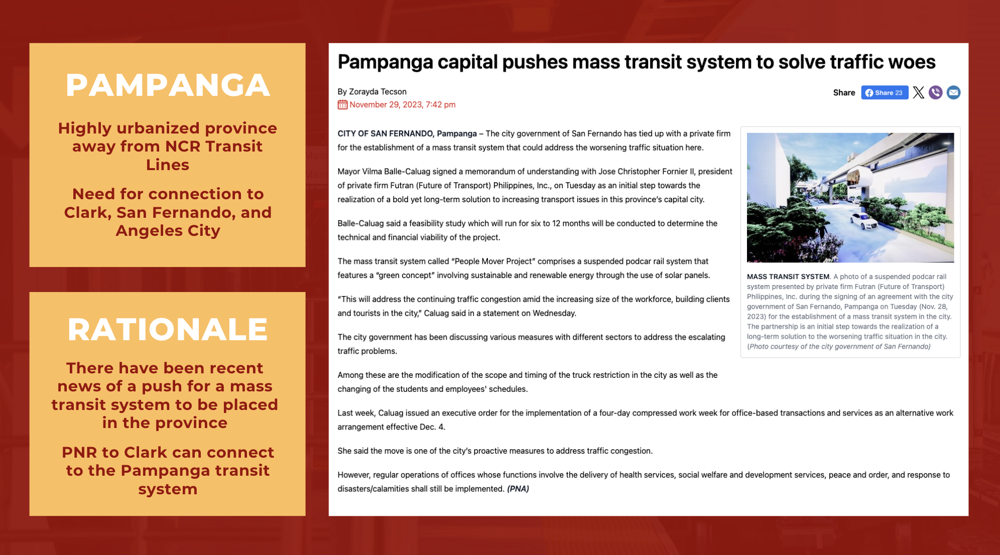

<a id='Header2'></a>
<h1 style="color:#ffffff; background-color:darkred; padding: 20px 0; text-align: left; font-weight: bold; padding-left: 20px;">DETERMINE BEST TRAIN STATION LOCATIONS (USING CLUSTER CENTROIDS)</h1><a id='ExecSum'></a><a id='Title'></a><a

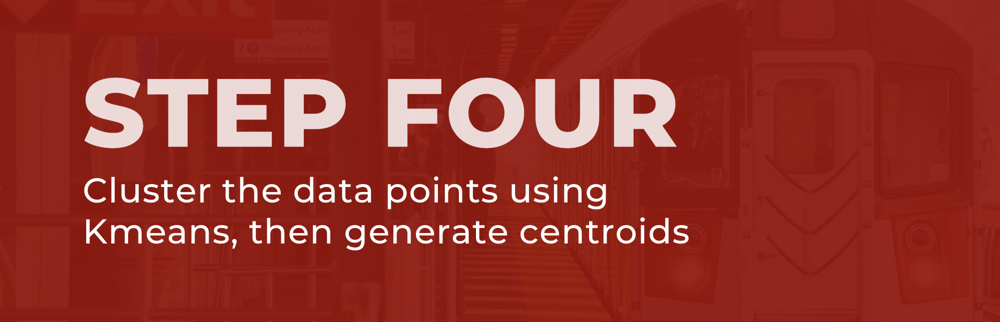

# **Cluster Based on Internal Validation Criteria**

In [50]:
df_removed['lon'] = df_removed['way2'].y
df_removed['lat'] = df_removed['way2'].x
df_clusters = df_removed[['lon', 'lat']]

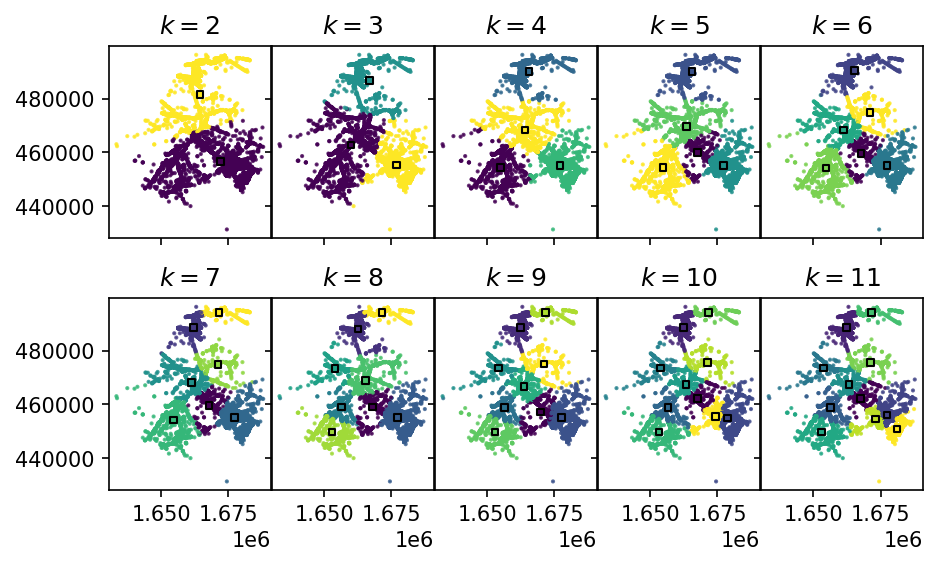

In [64]:
kmeans_trains = KMeans(n_clusters=2, random_state=1337, n_init='auto')
res_trains = cluster_range(df_clusters.to_numpy(), kmeans_trains, 2, 11)
plot_clusters(df_clusters.to_numpy(), res_trains['ys'], res_trains['centers'], 2)
plt.show()

In [73]:
%%capture
kmeans_trains = KMeans(n_clusters=5, random_state=1337, n_init='auto')
kmeans_trains.fit_transform(df_clusters)

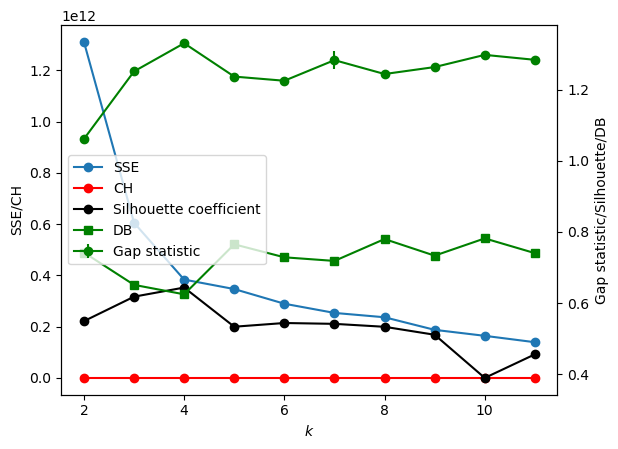

In [74]:
fig, ax = plt.subplots()
plot_internal(
    ax,
    res_fashion["inertias"],
    res_fashion["chs"],
    res_fashion["scs"],
    res_fashion["dbs"],
    res_fashion["gss"],
    res_fashion["gssds"],
)
plt.show()

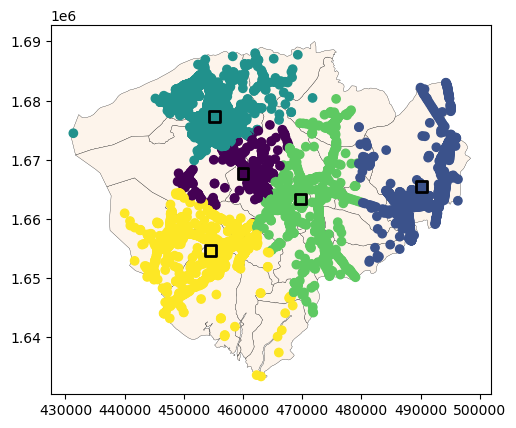

In [76]:
y_predict_trains = kmeans_trains.fit_predict(df_clusters)
centroids = kmeans_trains.cluster_centers_
ax = cities_pampanga.plot(color='#FDF4EB', edgecolor='black', linewidth=0.2)
ax.scatter(df_clusters.iloc[:, 1], df_clusters.iloc[:, 0], c=y_predict_trains)
ax.scatter(
    centroids[:, 1],
    centroids[:, 0],
    s=60,
    c=range(kmeans_trains.n_clusters),
    marker="s",
    ec="k",
    lw=2,
)
plt.show()

#### Relying on the internal validation statistics yields a low number of stations which might not connect areas in pampanga quite efficiently.

# **Cluster Based on Walkable Distance (800 Meters)**

### **Get Pampanga Area**

In [79]:
area_pampanga = pd.read_sql("""
SELECT
    ST_AREA(ST_UNION(ST_TRANSFORM(geom, 3123)))
FROM
    adm_2
WHERE
    adm_2."NAME_1" = 'Pampanga'
""", con=conn)

/var/folders/l2/tjtfb3_n2g91w6pt65qtdzlr0000gn/T/ipykernel_1240/566375618.py:1: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  area_pampanga = pd.read_sql("""


### **Get Hazard Areas**

In [80]:
area_landslide = gpd.read_postgis("""
SELECT 
    ST_UNION(ST_TRANSFORM(pampanga_landslidehazards.geom, 3123)) as geom
FROM 
    pampanga_landslidehazards
WHERE 
    (pampanga_landslidehazards.aud = 2 OR pampanga_landslidehazards.aud = 3)
""", con=conn, geom_col='geom')

/Users/pmmedina/anaconda3/lib/python3.10/site-packages/geopandas/io/sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


In [81]:
area_floods = gpd.read_postgis("""
SELECT 
    ST_UNION(ST_TRANSFORM(pampanga_flood_100year.geom, 3123)) as geom
FROM 
    pampanga_flood_100year
WHERE 
    (pampanga_flood_100year.var = 2 OR pampanga_flood_100year.var = 3)
""", conn, geom_col='geom')

/Users/pmmedina/anaconda3/lib/python3.10/site-packages/geopandas/io/sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


In [82]:
area_slope = gpd.read_postgis("""
SELECT 
    ST_UNION(ST_TRANSFORM(slp_pampanga.geom, 3123)) as geom
FROM 
    slp_pampanga
WHERE 
    (slp_pampanga.slope_code = 'B' OR slp_pampanga.slope_code = 'C' OR slp_pampanga.slope_code = 'D' OR
    slp_pampanga.slope_code = 'E')
""", con=conn, geom_col='geom')

/Users/pmmedina/anaconda3/lib/python3.10/site-packages/geopandas/io/sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


In [83]:
area_landcover = gpd.read_postgis("""
SELECT 
    ST_UNION(ST_TRANSFORM(egdmis_landcover2015.geom, 3123)) as geom
FROM 
    egdmis_landcover2015
WHERE 
    (egdmis_landcover2015.agg12 = 'Inland Water' OR egdmis_landcover2015.agg12 = 'Marshland/Swamp' OR
    egdmis_landcover2015.agg12 = 'Fishpond')
AND
    egdmis_landcover2015.province = 'PAMPANGA'
""", con=conn, geom_col='geom')

/Users/pmmedina/anaconda3/lib/python3.10/site-packages/geopandas/io/sql.py:170: UserWarning: pandas only supports SQLAlchemy connectable (engine/connection) or database string URI or sqlite3 DBAPI2 connection. Other DBAPI2 objects are not tested. Please consider using SQLAlchemy.
  df = pd.read_sql(


### **Compute for Number of Train Stations**

In [84]:
hazardsList = [area_landslide, area_floods, area_slope, area_landcover]

In [85]:
rdf = gpd.GeoDataFrame(pd.concat(hazardsList, ignore_index=True) )

In [86]:
area_together = rdf.dissolve().to_crs(epsg=3123).area

In [91]:
total_usable_area = area_pampanga.iloc[0, 0] - area_together[0]

In [87]:
area_walkable = 800**2 * np.pi 

In [92]:
num_trains = total_usable_area / area_walkable

In [93]:
num_trains

499.75662966785615

### **Generate Train Station Locations**

In [94]:
%%capture
kmeans_trains = KMeans(n_clusters=499, random_state=1337, n_init='auto')
kmeans_trains.fit_transform(df_clusters)

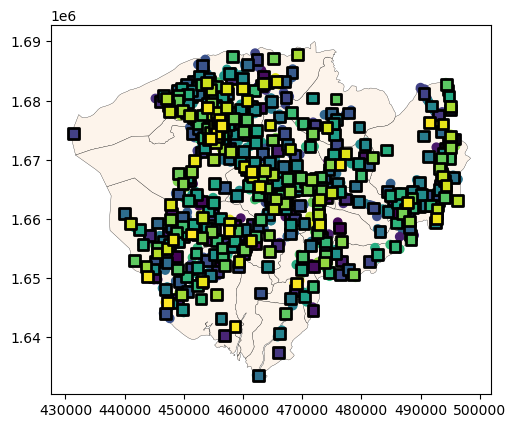

In [95]:
y_predict_trains = kmeans_trains.fit_predict(df_clusters)
centroids = kmeans_trains.cluster_centers_
ax = cities_pampanga.plot(color='#FDF4EB', edgecolor='black', linewidth=0.2)
ax.scatter(df_clusters.iloc[:, 1], df_clusters.iloc[:, 0], c=y_predict_trains)
ax.scatter(
    centroids[:, 1],
    centroids[:, 0],
    s=60,
    c=range(kmeans_trains.n_clusters),
    marker="s",
    ec="k",
    lw=2,
)
plt.show()

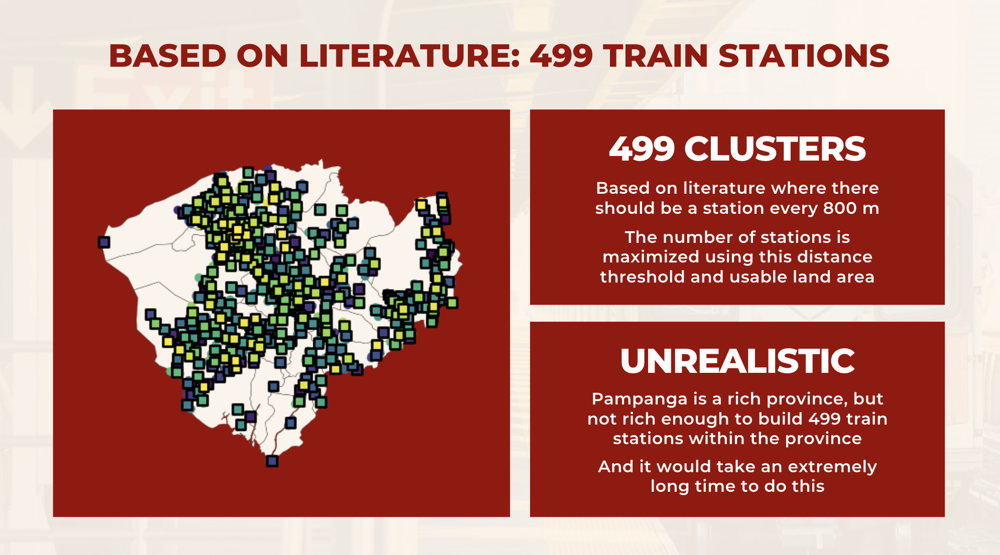

# **Cluster Based on Feasible Number of Train Stations (Number of Municipalities/Cities in Pampanga)**

In [96]:
%%capture
kmeans_trains = KMeans(n_clusters=22, random_state=1337, n_init='auto')
kmeans_trains.fit_transform(df_clusters)

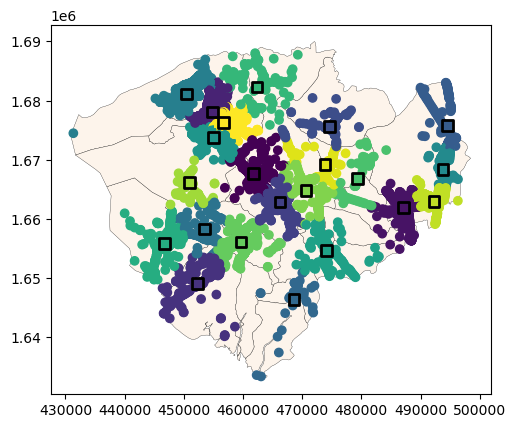

In [97]:
y_predict_trains = kmeans_trains.fit_predict(df_clusters)
centroids = kmeans_trains.cluster_centers_
ax = cities_pampanga.plot(color='#FDF4EB', edgecolor='black', linewidth=0.2)
ax.scatter(df_clusters.iloc[:, 1], df_clusters.iloc[:, 0], c=y_predict_trains)
ax.scatter(
    centroids[:, 1],
    centroids[:, 0],
    s=60,
    c=range(kmeans_trains.n_clusters),
    marker="s",
    ec="k",
    lw=2,
)
plt.show()

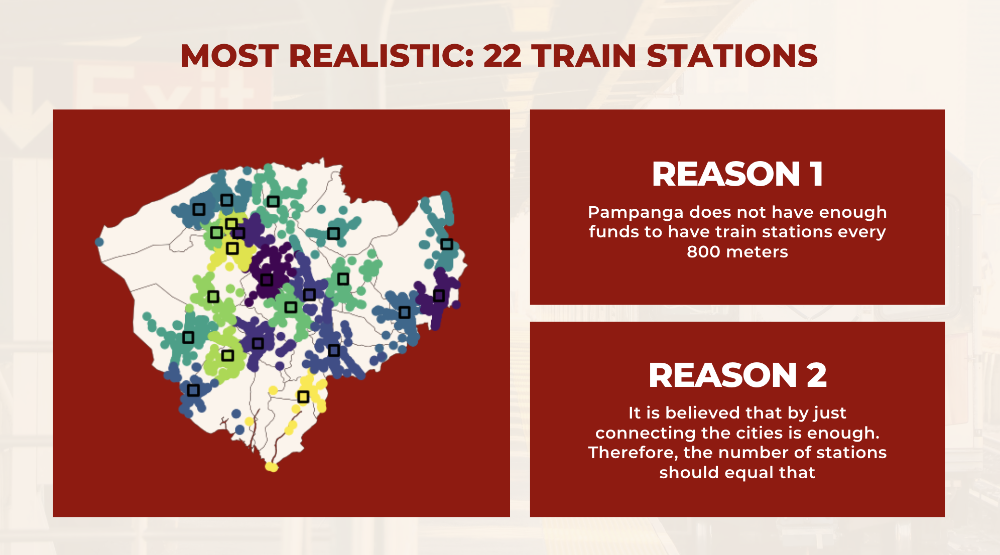